<a href="https://colab.research.google.com/github/ashvar1/helloworld/blob/master/webScrapingWithPythonPart1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Some terms in this notebook are in bold, blue, and underlined, like the following: [**web scraping**](#scrollTo=w8uce2RFUNAf). If you see a term that's in bold, that means that it's defined in the Glossary section at the bottom of this page. Clicking a term in bold will take you to its definition. The term only appears in bold the first time it appears in the notebook.

Here is the link to the presentation slides for this class: https://docs.google.com/presentation/d/12x-JJVvHEWmctBvMXWVa3V_Kh1zkTT52X-D42_Bg9Yo/edit?usp=sharing

# Preparatory Code

Before we do anything, we need some code to get us started. The following code cell imports all of the [**libraries**](#scrollTo=gub_2dgjQXst) we will need for this class. Make sure to run this cell (which we can do by pressing the play button on the left side of the cell) before running any other code.

In [ ]:
#allows us to access the internet from our Python programs
import requests

#provides us with functions to search through the HTML of a web page
from bs4 import BeautifulSoup

#pretty print, this displays text in a "nice" way
from pprint import pprint

Below is a function that capitalizes the first letter of each word. We will use this to make the book titles from the bestsellers list look like actual titles. This comes directly from the python docs except that I replaced the apostrophe with '^ '. The code I took is the third code block in the following link: https://docs.python.org/3/library/stdtypes.html#str.title

How this function works doesn't matter, since we're just taking code directly from the python docs. For a nice introduction to regular expressions (that's what is used below), check out the PyCon talk at the following link: [Yes, It's Time to Learn Regular Expressions](https://www.youtube.com/watch?v=abrcJ9MpF60)

Make sure to run this cell before running any other code.

In [ ]:
import re
def titlecase(s):
    '''
    This takes in a string, capitalizes the first letter of every word 
        and puts every other letter into lowercase'''
    return re.sub(r"[A-Za-z]+([^ ][A-Za-z]+)?",
                  lambda mo: mo.group(0).capitalize(),
                  s)

# First Try at NYT Bestsellers

We will start off by scraping the New York Times Bestsellers list. Specifically, our goal is to get all of the categories and book titles on the list. The exact link is [NYT Bestsellers List](https://www.nytimes.com/books/best-sellers/).

## Mapping out a solution

We want to take a look "under the hood" of the website, so let's open up [**Developer Tools**](#scrollTo=qsl8NAb3QOgq).

### Developer Tools Intro

 To do that, right click anywhere on the page, and a menu should pop up like the one below.

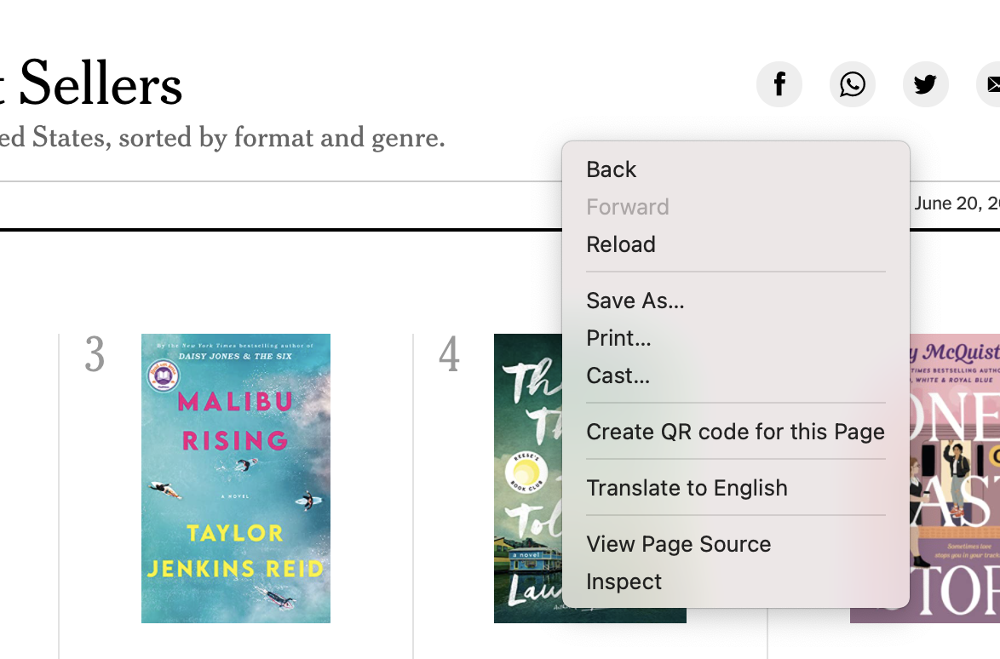

Then click Inspect. A window like the one below should pop up.

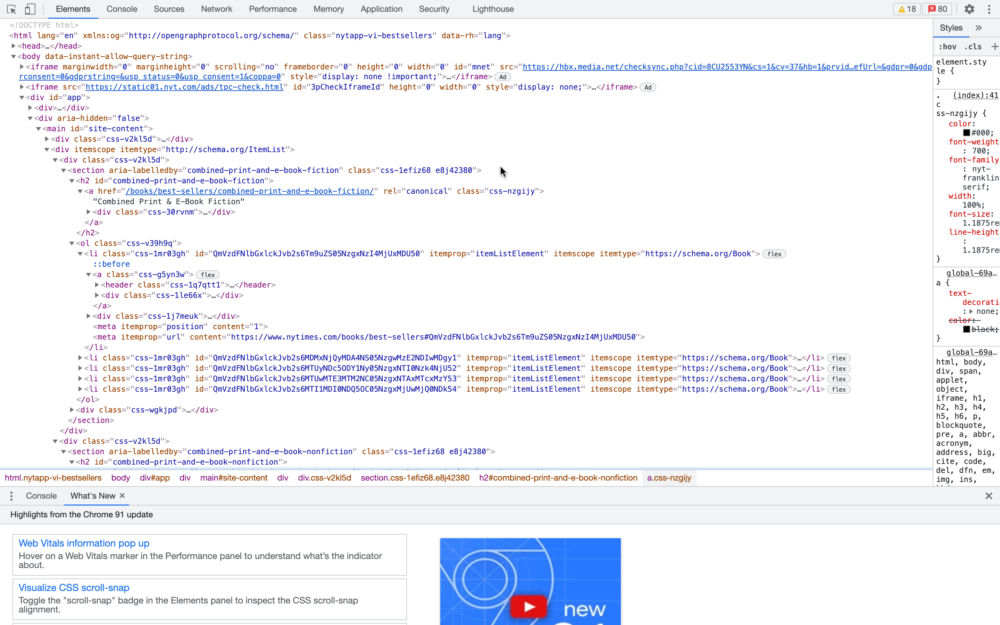

We want to make sure that we're on the Elements tab of Developer Tools. When we hover over an [**HTML element**](#scrollTo=dJD25XUAz_AH) in Developer Tools, notice that the corresponding object on the page is highlighted. In the image below, my cursor on the right is hovering over the *h3* element (*h3* is the element's [**tag**](#scrollTo=KYu6klsVQUwx)) containing the book title "How the Word is Passed", and that's the same object that is highlighted on the actual website on the left.

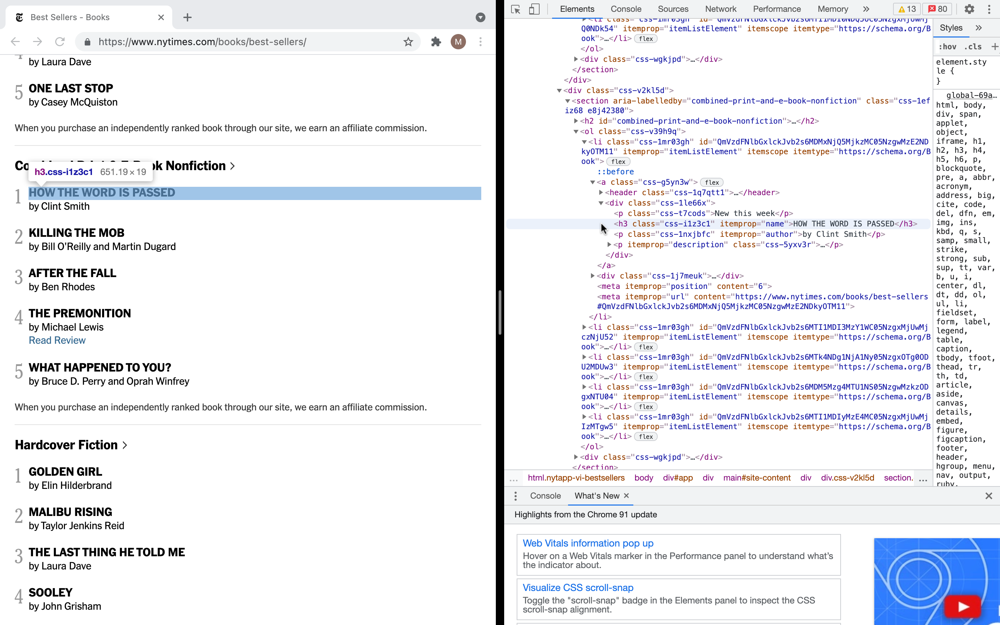

### Locating Category Name

Using this highlighting feature, we can locate the first category name in Developer Tools,

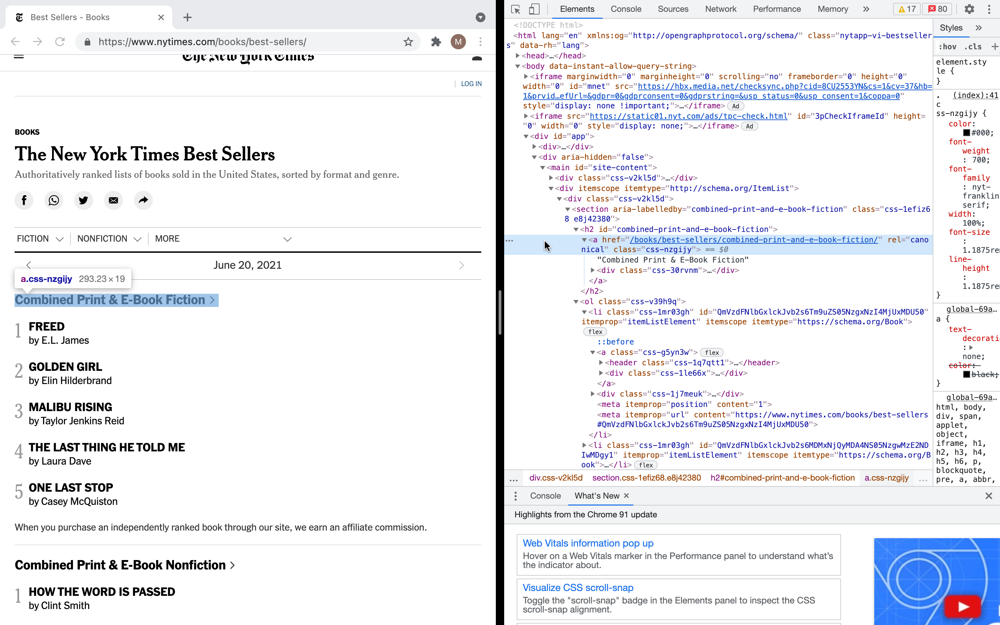

and we see that one of its [**attributes**](#scrollTo=HMvKArft0DTV) is class="css-nzgijy", so we might guess that every element containing the name of a category has that same class attribute. It turns out that if we navigate to the second category name in Developer tools,

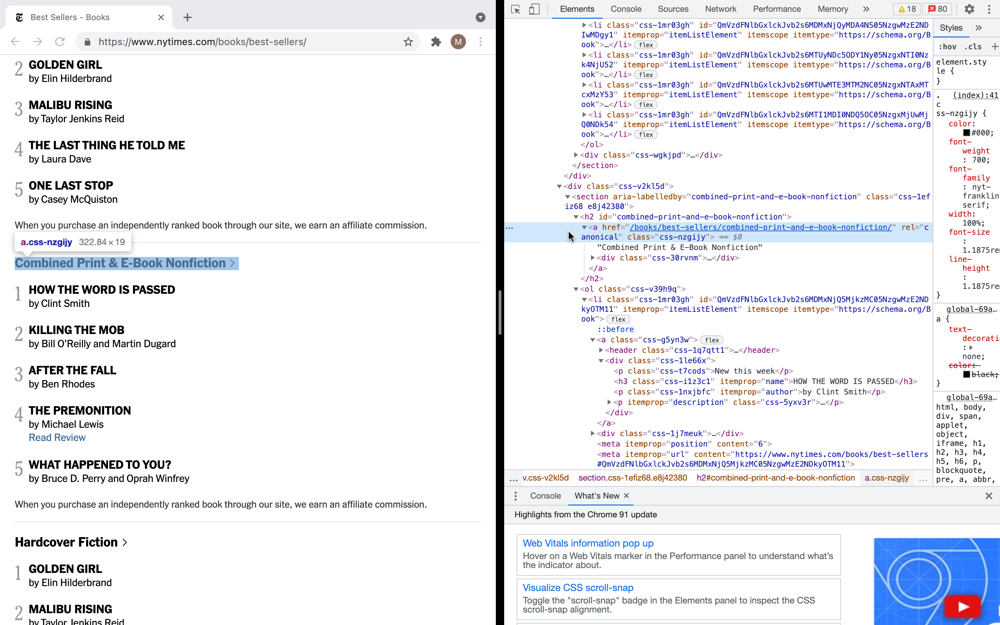

the element containing that category name has the same class attribute. This suggests that, to find all of the category names, we should look for all of the elements whose class attribute matches "css-nzgijy".

### Locating Book Titles

Just like we located the category name in Developer Tools, we can also locate one of the book titles.

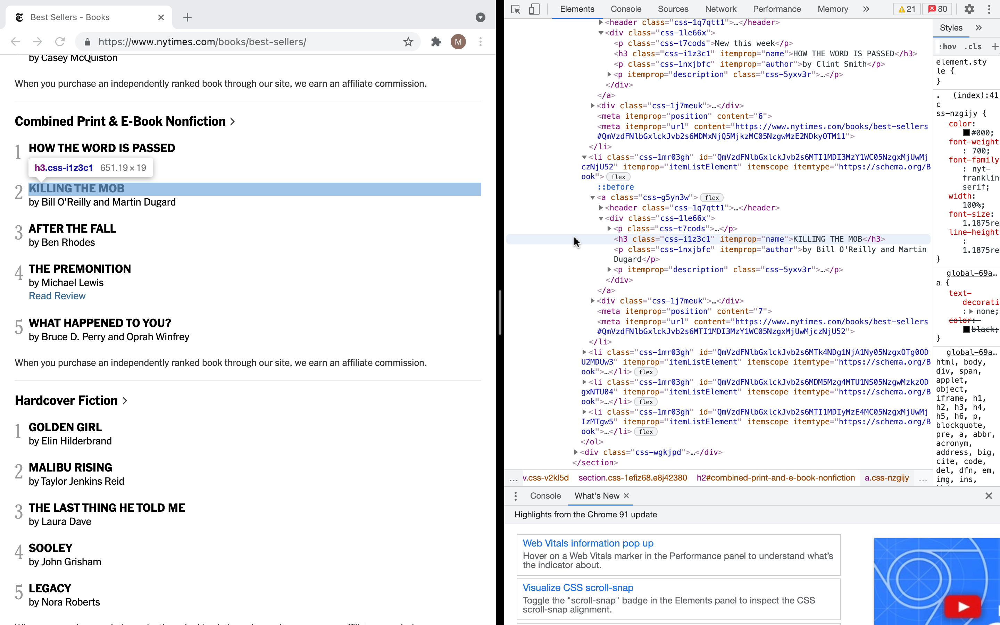

Notice that, in the image above, the HTML element containing the title of a book has the attribute class="css-i1z3c1", so we might guess that every element containing the name of a book title has that same class attribute. In fact, if we locate another book title in Developer Tools,

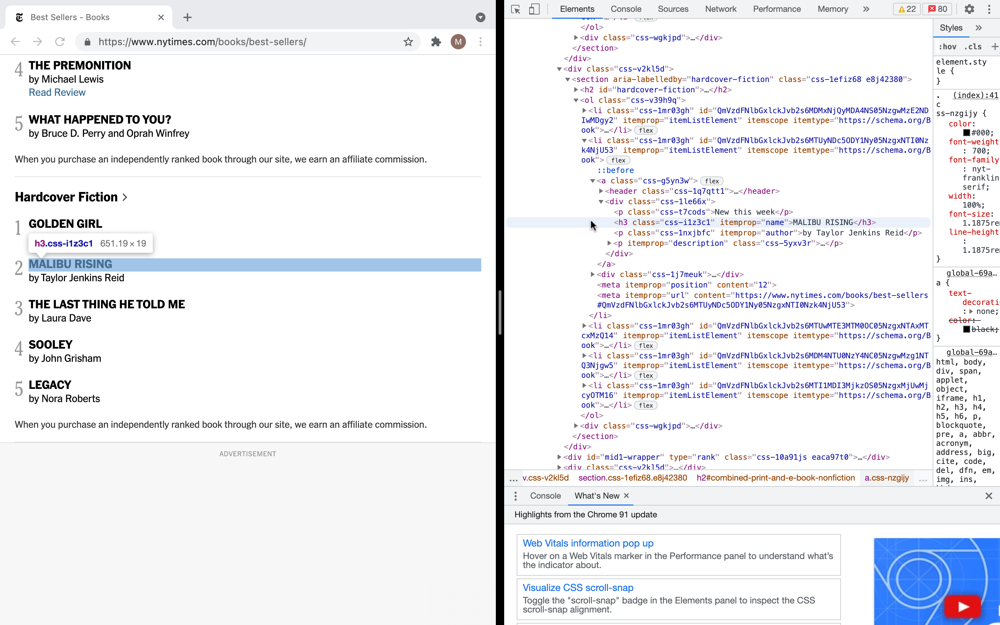

the element containing that book title has the same class attribute. This suggests that to find all of the book titles on the page, we can look for all of the elements whose class attribute matches "css-i1z3c1".

## Code

Now that we have a plan of attack, we can start writing code.

In [ ]:
#website we're going to scrape
url = "https://www.nytimes.com/books/best-sellers/"

#standard boilerplate code we will use every time we do web scraping
page = requests.get(url)
soup = BeautifulSoup(page.content, 'html.parser')

#obtains all of the book titles on the page
bookTitlesHtml = soup.find_all(class_ = 'css-i1z3c1')
bookTitles = []
for bookTitleHtml in bookTitlesHtml:
    bookTitles.append( titlecase(bookTitleHtml.text) )

#obtains all of the categories on the page
categoriesHtml = soup.find_all(class_ = 'css-nzgijy')
categories = []
for categoryHtml in categoriesHtml:
    categories.append( categoryHtml.text )

#puts the categories and book titles together in one list
bestsellerList = []
for index, category in enumerate(categories):
    bookTitlesList = bookTitles[5*index: 5*index + 5]
    categoryAndBooks = {"Category": category, "Top Five Books": bookTitlesList}
    bestsellerList.append(categoryAndBooks)

#displays the categories and books we've obtained from the bestseller list in a nice way
pprint(bestsellerList)

The above code cell gets the categories and the books from the current week's bestsellers list and puts them together in a nice way. But what if we want to get the bestsellers list from a different week?

## Generalize our work

We can navigate to a previous week by clicking the button immediately to the left of the date. This is the button in the green circle in the image below.

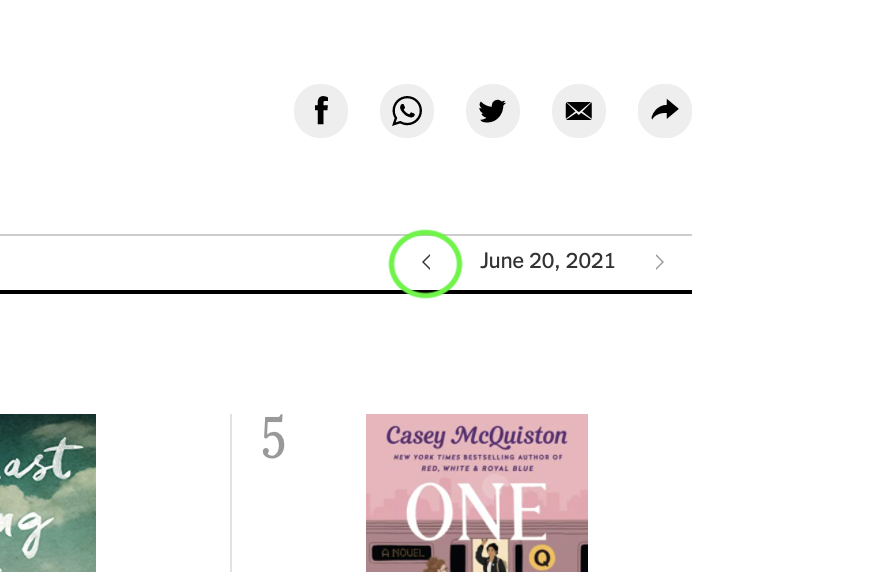

Notice that now the URL has changed to align with the date. In the image below, we're looking at the bestsellers list of June 13, 2021, and the URL now ends with 2021/06/13/. 

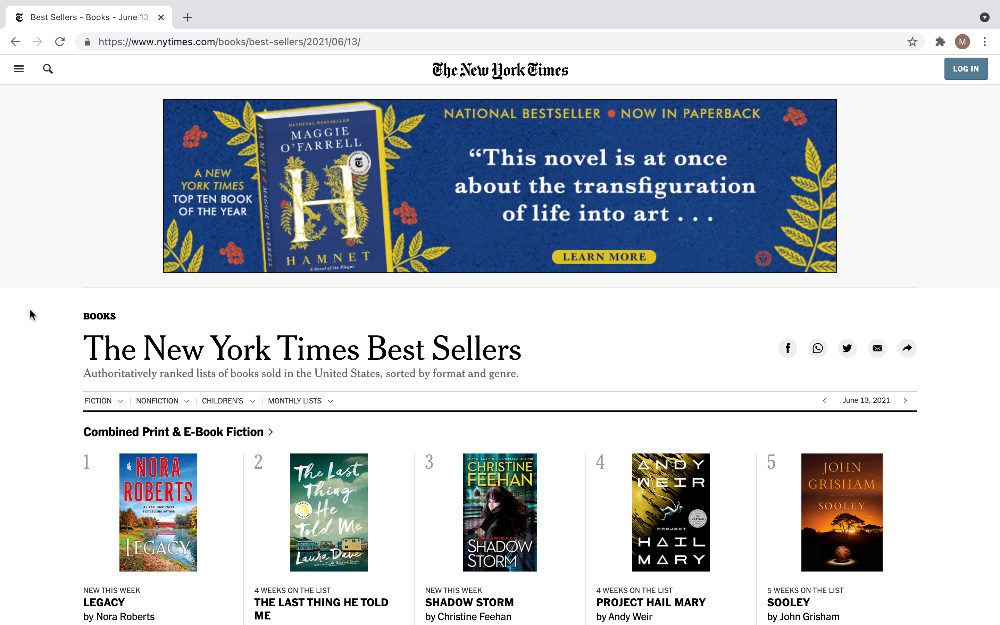

This seems to suggest that in order to get the bestsellers list of any date, we just need to add the date onto the end of the URL. This is exactly what we do in the following cell:

In [ ]:
def getBestsellerList(year, month, day):
    '''
    Returns the NYTimes Bestsellers List for the given date specified by year, month, day.
    The return type is a list where each element in it is a dictionary representing each 
    of the 11 categories on the list. Each dictionary has two keys, "Category" and "Top Five Books", 
    whose corresponding values are the name of the category and a list of the titles of the 
    top five books in that category. Each of the book titles is a string.

    year is a string with 4 digits 
    month is a string with 2 digits, anything from 01-12
    day is any two digit string from 01 to the number of days in the month indicated by the argument 'month'
    '''

    #fills in the url to get the nyt bes                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         tseller list for the date indicated by the arguments year, month, and day
    url = f"https://www.nytimes.com/books/best-sellers/{year}/{month}/{day}/"

    #standard boilerplate code we will use every time we do web scraping
    page = requests.get(url)
    soup = BeautifulSoup(page.content, 'html.parser')

    #bookTitles is a list of the html tags containing the book titles in each of the 11 lists on the website
    bookTitlesHtml = soup.find_all(class_ = 'css-i1z3c1')

    #categories is a list of the html tags containing the names of the 11 lists on the website
    categoriesHtml = soup.find_all(class_ = 'css-nzgijy')

    #here we use list comprehension to get the actual text of the book titles and names of categories
    #titlecase() capitalizes the first letter of every word. This makes the book titles look like titles
    bookTitles = [titlecase(title.text) for title in bookTitlesHtml]
    categories = [category.text for category in categoriesHtml]

    #packages everything in a list of dictionaries. this is fairly arbitrary, but it's a nice structured form for the data
    bestsellerList = [{"Category": category, "Top Five Books": bookTitles[5*index: 5*index+5]} for index, category in enumerate(categories)]

    return bestsellerList

#displays the bestseller list of May 23rd, 2020
pprint( getBestsellerList('2020', '05', '23') )

# Second Try at NYT Bestsellers

Our goal here is the same as before, to scrape the New York Times bestsellers list, but whereas in the first try we searched by attribute name, here we're going to search by tag name and show off some other functions that Beautiful Soup provides us with.

## Mapping out a solution

### Locating Book Titles

Open up Developer Tools, and notice that each block of five books in a category is in an *ol* element.

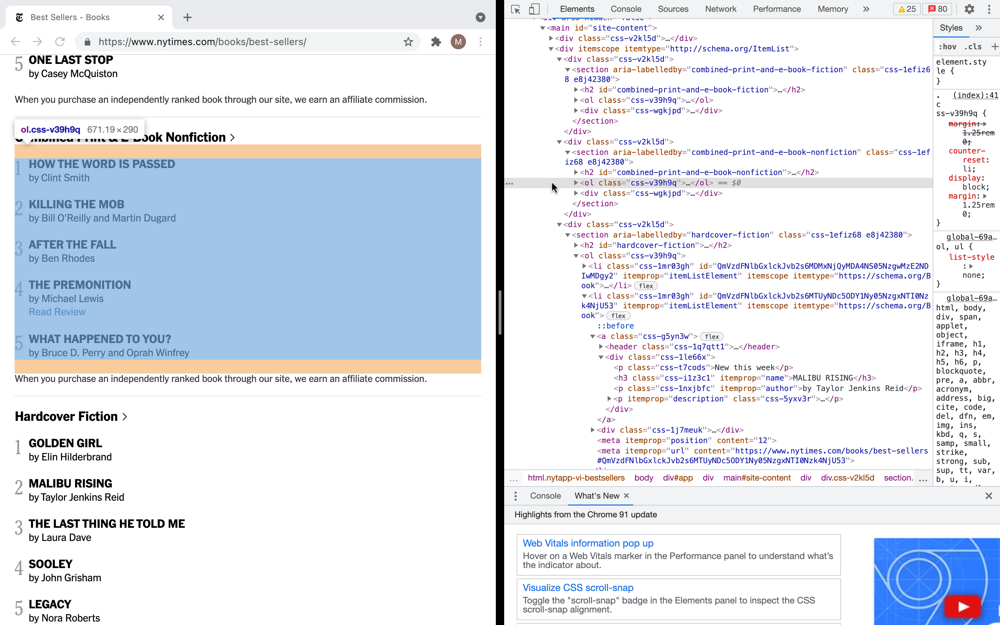

If we look at the contents of that ol element by clicking the triangle icon to the left of it, we see that each book is in an *li* element,

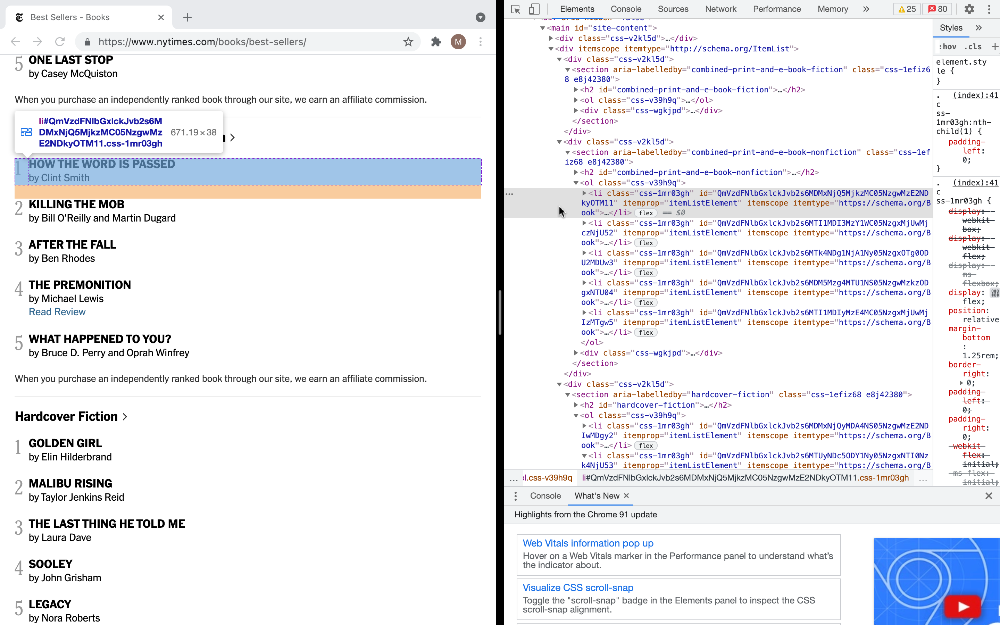

and if we look at the contents of that li element, we will see that the book title is in an *h3* the element; that element is in a *div*; and that element is in an *a*.

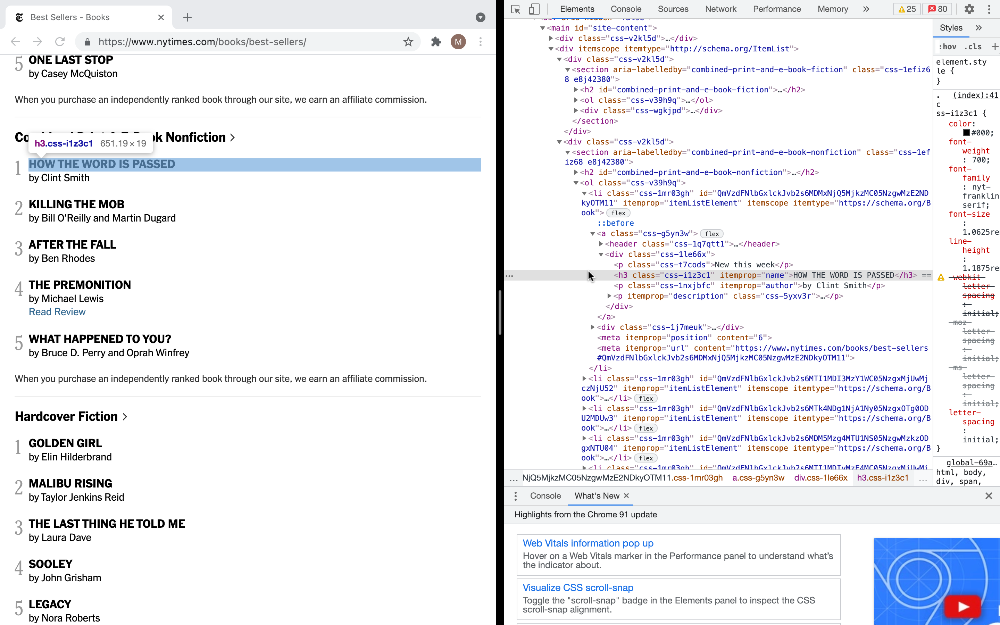

This suggests that to get the names of the books from an *ol* element, we should search for all of the *li* elements inside of it, then from each of those *li* elements we should navigate to the first *a* element inside of it, then to the first *div* element inside of that, and finally to the first *h3* element inside of that.

### Locating Category Name

Just like we located the book titles, we can also locate the category names. Notice that the *h2* element right before the *ol* element we found earlier contains the name of the category.

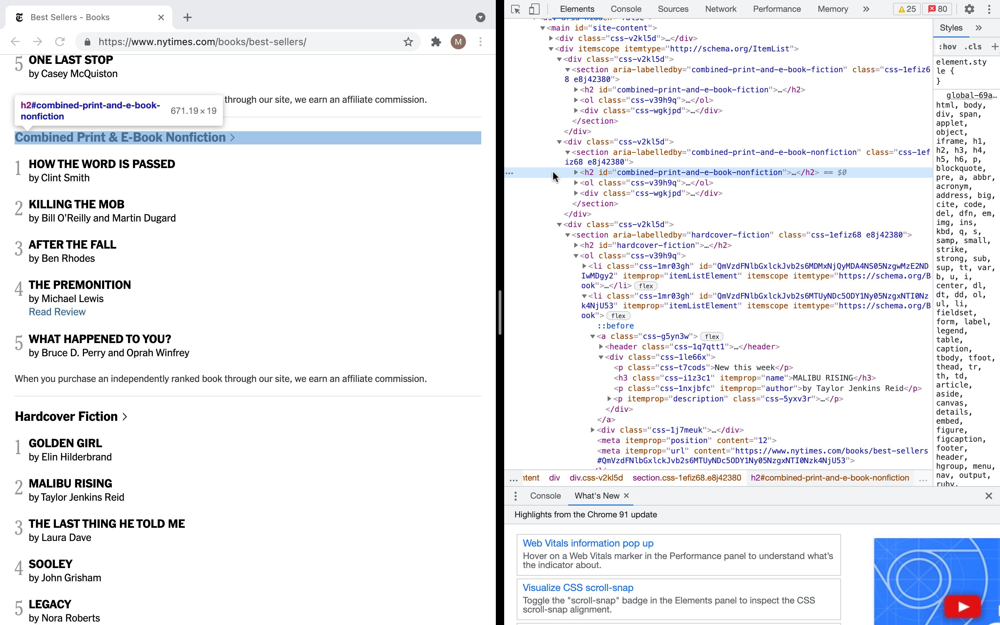

In fact, the only text inside of that *h2* element is the name of the category,

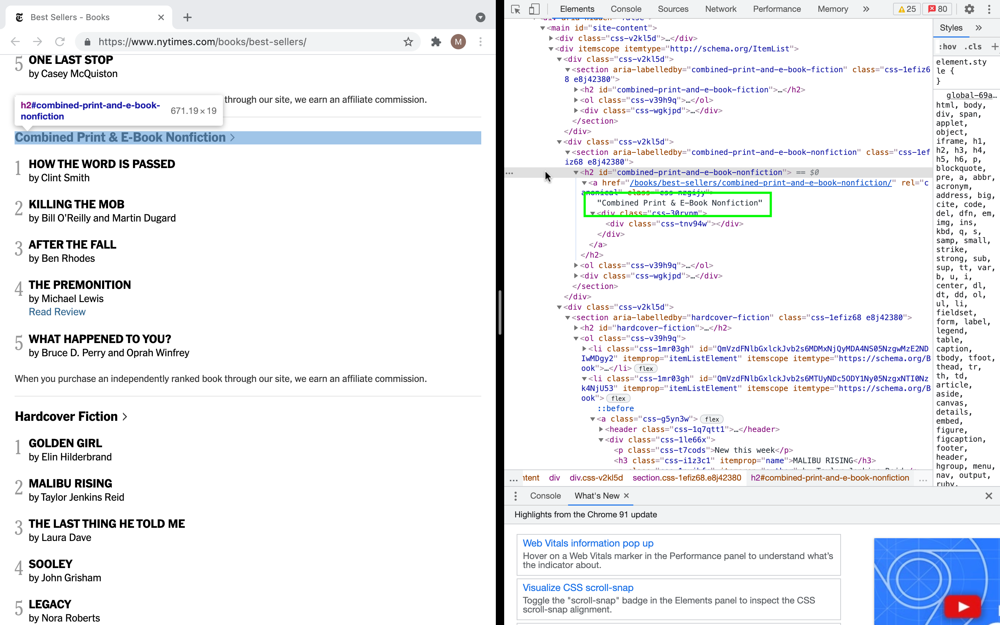

so all we need to do to obtain the category name from one of the *ol* elements is to locate the element right before it and then get the text of that element.

## Code

Now that we have a plan of attack, we can start writing code.

In [ ]:
#website we're going to scrape
url = "https://www.nytimes.com/books/best-sellers/"

#standard boilerplate code we will use every time we do web scraping
page = requests.get(url)
soup = BeautifulSoup(page.content, 'html.parser')

#list that will contain all of the categories and book titles
bestsellerList = []

#list of 'ol' elements, every category is contained in one of these
categoriesHtml = soup.find_all('ol')
for categoryHtml in categoriesHtml:
    #this extracts the name of the current category
    category = categoryHtml.previous_sibling.text

    htmlEnclosingBooks = categoryHtml.find_all('li', recursive=False)
    bookTitles = []
    for bookHtml in htmlEnclosingBooks:
        #this extracts the title of the current book and adds it to the list
        bookTitles.append( titlecase( bookHtml.a.find('div', recursive=False).h3.text ) )

    #packages everything in a list of dictionaries. this is fairly arbitrary, but it's a nice structured form for the data
    bestsellerList.append({"Category": category, "Top Five Books": bookTitles})

#displays the categories and books we've obtained from the bestseller list in a nice way
pprint(bestsellerList)

[{'Category': 'Combined Print & E-Book Fiction',
  'Top Five Books': ['The Last Thing He Told Me',
                     "The President's Daughter",
                     'Malibu Rising',
                     'Where The Crawdads Sing',
                     'People We Meet On Vacation']},
 {'Category': 'Combined Print & E-Book Nonfiction',
  'Top Five Books': ['The Body Keeps The Score',
                     'Killing The Mob',
                     'The Bomber Mafia',
                     'Greenlights',
                     'Untamed']},
 {'Category': 'Hardcover Fiction',
  'Top Five Books': ["The President's Daughter",
                     'The Last Thing He Told Me',
                     'Malibu Rising',
                     'The Midnight Library',
                     'Golden Girl']},
 {'Category': 'Hardcover Nonfiction',
  'Top Five Books': ['Killing The Mob',
                     'The Bomber Mafia',
                     'Greenlights',
                     'Untamed',
                   

## Generalize our work

If we want to write a function that obtains the bestsellers list for any given date using the code we wrote above, we can do it in the same way we did in the first try:

In [ ]:
#year is a string with 4 digits, month is any two digit string from 01-12,
#   and day is any two digit string from 01 to the number of days in the month indicated by the argument 'month'
def getBestsellerList(year, month, day):
    '''
    Returns the NYTimes Bestsellers List for the given date specified by year, month, day.
    The return type is a list where each element in it is a dictionary representing each 
    of the 11 categories on the list. Each dictionary has two keys, "Category" and "Top Five Books", 
    whose corresponding values are the name of the category and a list of the titles of the 
    top five books in that category. Each of the book titles is a string.

    year is a string with 4 digits 
    month is a string with 2 digits, anything from 01-12
    day is any two digit string from 01 to the number of days in the month indicated by the argument 'month'
    '''
    
    #fills in the url to get the nyt bestseller list for the date indicated by the arguments year, month, and day
    url = f"https://www.nytimes.com/books/best-sellers/{year}/{month}/{day}/"

    #standard boilerplate code we will use every time we do web scraping
    page = requests.get(url)
    soup = BeautifulSoup(page.content, 'html.parser')

    #creates empty list that will hold the book info we're scraping
    bestsellers = []

    #categories is a list of the ol tags on the page. The ol tags contain the list of five books in the category and
    #   are right next to the tags containing the category name
    categories = soup.find_all('ol')
    for category in categories:
        #categoryName contains the name of the current category
        categoryName = category.previous_sibling.text

        #all of the books are enclosed in li tags. We set recursive=False because we only want to consider the ol tag's
        #   direct children
        htmlEnclosingBooks = category.find_all('li', recursive=False)

        #creates empty list that will hold the list of book titles for the current category
        books = []
        for bookHtml in htmlEnclosingBooks:
            #this extracts the title of the current book and adds it to the list
            books.append( titlecase( bookHtml.a.find('div', recursive=False).h3.text ) )

        #packages everything in a list of dictionaries. this is fairly arbitrary, but it's a nice structured form for the data
        bestsellers.append({"Category": categoryName, "Top Five Books": books})

    #all of the code after the standard boilerplate can be replaced with the following line!
    #bestsellers = [{"Category": category.previous_sibling.a.text, "Top Five Books": [book.a.find('div', recursive=False).h3.text.title() for book in category.find_all('li', recursive=False)]} for category in soup.find_all('ol')]
    #comment out or delete the code on lines 12-33 and uncomment the above line to see it in action

    return bestsellers

#displays the bestseller list of January 10th, 2020
pprint( getBestsellerList('2020', '01', '10') )

# Using the Data (example)



If we scrape data from a website, then we should do something with that data. The following code is an example of that. 

In these code cells, there is a function called displayMostPopularAuthors that displays a bar chart of the twenty authors who have appeared the most on the Bestsellers list over the past year. This code retrieves the names of the authors using some of the same tools we used to retrieve the category names and the book titles. This code is independent of all of the other code cells in this notebook, in the sense that you do not need to run any other code cell other than the ones below in order to see how the function works.

First run all of the code cells in the section below, Preparatory Code, then run the code cell in the section following that, Calling the Function. The code cell in Calling the Function may take up to a minute or two to run, since it accesses the Bestsellers list for every week over the past year. You can play around with the number of authors displayed by changing the argument.

## Preparatory Code

In [ ]:
from collections import Counter
import re
import requests
from bs4 import BeautifulSoup
from datetime import datetime
import plotly.express as px

In [ ]:
def splitOnMultipleValues(text, splitList):
    """
    Splits text at all of the boundaries
    in splitList. Returns a list of the split text.

    text: str
    splitList: list[str]
    return: list[str]
    """

    elements = [text]
    for splitText in splitList:
        newElements = []
        for element in elements:
            newElements.extend([item.strip() for item in element.split(splitText)])
        elements = newElements
    return elements

In [ ]:
def getAuthorsFromSoup(soup):
    """
    Return a list of all of the authors in the bestsellers
    list for the list in soup.

    soup: soup object of the HTML for a bestsellers list
    return: list[str]

    reqs: from bs4 import BeautifulSoup
          import re
    """

    authors = [] #list to hold the authors
    #I add a period to make the regular expression more easily match what I want
    authorTextList = [authorElement.text + "." for authorElement in soup.find_all(itemprop="author")]
    for authorText in authorTextList:
        #matches everything between "by " and a period,
        #but only a period preceded by at least two word characters
        #this prevents authors like "J. K. Rowling" from having
        #their names split down the middle
        for authorGroup in re.findall(r"(?<=by )(.*?\w{2,}(?=\.))", authorText):
            authors.extend( splitOnMultipleValues(authorGroup, [",", " and ", " with "]) )
    return authors

In [ ]:
def getTopAuthorAppearancesOnBestsellersList():
    """
    Return a Counter object with all of the authors
    that have appeared in the bestsellers list over
    the past year and the number of times each of
    them has appeared on the list.

    return: Counter

    reqs: from datetime import datetime
          import requests
          from bs4 import BeautifulSoup
          from collections import Counter
          import re

    strategy:
    over the past year
    1. access bestsellers list
    2. jot down current date
    3. add authors from current list to counter
    4. get previous week's link
    5. repeat 1 with link from 4 until date is a year back
    """

    currentDate = datetime.today().date()
    listIsLessThanAYearBack = True #this week's list is less than a year back
    formattedDate = currentDate.strftime("%Y/%m/%d/")

    authorCount = Counter() #keep track of number of times each author appears
    while listIsLessThanAYearBack:
        #standard boilerplate
        url = f"https://www.nytimes.com/books/best-sellers/{formattedDate}"
        page = requests.get(url)
        soup = BeautifulSoup(page.content, "html.parser")

        #add authors to the running total
        authorCount.update(getAuthorsFromSoup(soup))
        
        formattedDate = soup.find(rel="prev")["href"][-11:]
        dateOfList = datetime.strptime(formattedDate, "%Y/%m/%d/").date()
        listIsLessThanAYearBack = (currentDate - dateOfList).days < 365

        #I included these two print statements for debugging purposes,
        #but they are genuinely useful to see the progress of the function
        print(formattedDate)
        print(authorCount)

    return authorCount

In [ ]:
def displayMostPopularAuthors(numberOfAuthors):
    """
    Display the top numberOfAuthors on the bestsellers list over
    the past year in a bar chart.

    numberOfAuthors: int

    reqs: from datetime import datetime
          import requests
          from bs4 import BeautifulSoup
          from collections import Counter
          import urllib.parse
          import plotly.express as px
    """
    
    authorCount = getTopAuthorAppearancesOnBestsellersList()
    mostCommonAuthors = authorCount.most_common(numberOfAuthors)
    authors = [entry[0] for entry in mostCommonAuthors]
    appearances = [entry[1] for entry in mostCommonAuthors]

    fig = px.bar(x=authors, 
                y=appearances, 
                title="Twenty Authors with Most Appearances on Bestsellers List in Past Year",
                labels={
                    "x": "Authors",
                    "y": "Number of Appearances"
                })
    fig.show()

## Calling the Function

In [ ]:
displayMostPopularAuthors(20)

# Glossary

* ***Web scraping*** - the process of extracting information from websites ([Back](#scrollTo=XOGwZgr7nNGI))

* ***API*** - short for Application Programming Interface, this is a list of functions that you can call for a particular application/service. On a website, instead of forcing a user or programmer to interact with their raw data, often they will provide a list of functions (API) so that the user can interact with the website’s data in a clean way.

* ***Developer Tools*** - this is a set of resources we can use to learn more about the website we're on. Here we can see the Elements, Console, Sources, and Network sections, in addition to a few others. Elements shows us the HTML of the page, and this is the only part of Developer Tools we use during this class. Console shows us any messages sent by the website, Sources shows us the code that makes up the website (it's more than just HTML), and Network shows us the online resources the website uses. ([Back](#scrollTo=gn5DQXg3Q6of))

* ***HTML*** - hypertext markup language, it’s the code that tells our browser how to render (display) a particular webpage. Below is an example of what HTML looks like.

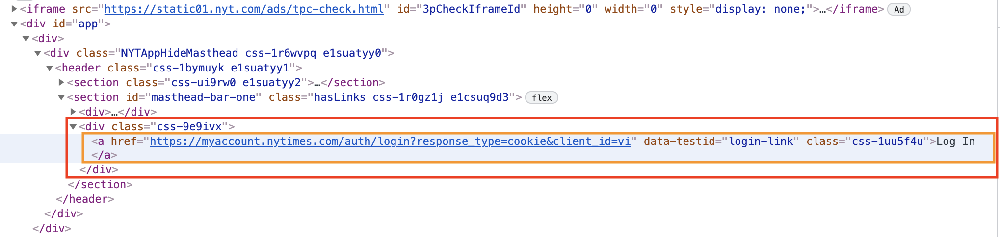


* ***Element (HTML)*** - a part of a webpage. An element may contain data, a chunk of text or an image, or perhaps nothing. A typical element consists of an opening tag with some attributes, enclosed text content, and a closing tag. The orange and red boxes in the image above are both elements (an element can contain another element). ([Back](#scrollTo=Px0k3OmdmH-M))

* ***Tag (HTML)*** - used for creating an element, we can think of a tag as the name of an element, and it is the purple text inside of angle brackets, like \<p\> for paragraph. The tag tells us what the purpose of an element is. In the image below, the *a* inside the blue circle is the tag of that element. Notice that tags are italicized throughout this notebook. ([Back](#scrollTo=Px0k3OmdmH-M))

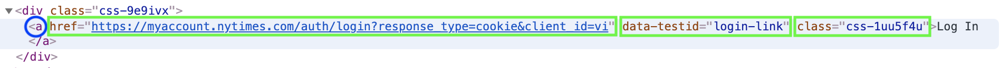


* ***Attributes (HTML)*** - an attribute changes an element’s behavior or provides information about the element. The green boxes in the above image are all of the attributes of the *a* element. ([Back](#scrollTo=ejbFZtpymuQC))

* ***Library/Package*** - code written by other people that we can use in our own programs. We use an import statement to get access to the code in a library/package. Library and package mean the same thing, so I will use them interchangeably. I import all of the packages in the "Preparatory Code" section. ([Back](#scrollTo=KRzLCGMV4D0h))

* ***Parser*** - a piece of software that does parsing. To parse something essentially means to read it and make sense of it.

# Places to Continue Learning

* [Installing Python](https://realpython.com/installing-python/)
    * If you would like to run Python code without requiring an internet connection, you need to install it locally on your computer. This link contains great instructions on how to do that.
* [Beautiful Soup Documentation](https://www.crummy.com/software/BeautifulSoup/bs4/doc/)
* [Web Scraping Tutorial](https://realpython.com/beautiful-soup-web-scraper-python/)
* [Automate the Boring Stuff with Python by Al Sweigart](https://automatetheboringstuff.com/)
    * This is a great book that shows how to write Python programs that perform useful and time-consuming tasks in a fraction of a second. One of the topics the author discusses is web scraping (Chapter 12), but he uses different functions in Beautiful Soup than the ones we used in this class, so it's still an interesting read. This link is to the book itself, which is available online for free!


In addition to the above resources, NYPL offers free courses on Linkedin Learning to anyone with a library card. We recommend the following courses on that platform:
* Working with Databases
    1. [MySQL Installation and Configuration](https://www.linkedin.com/learning/mysql-installation-and-configuration/)
        * After scraping a website for some data, we may need some place to store that data. For that, we could use a database. MySQL is a free, popular database management system, and this course covers how to install and set it up.
    2. [Advanced Python: Working with Databases](https://www.linkedin.com/learning/advanced-python-working-with-databases)
        * Chapter 3 of this course covers how to use MySQL with Python.
    3. [MySQL Essential Training](https://www.linkedin.com/learning/mysql-essential-training-2?u=73722380)
        * This course covers how to use MySQL in general and also serves as a good introduction to SQL, the most common language used to communicate with databases.
* [Python Data Analysis](https://www.linkedin.com/learning/python-data-analysis-2/)
    * This is a course on data analysis in Python. It covers Python data structures like lists, tuples, dictionaries, and sets; great features in Python like comprehensions and the collections and itertools modules; and it spends a lot of time talking about numpy and pandas, which are great for dealing with data and doing math with it.
* [Python for Data Science Essential Training](https://www.linkedin.com/learning/python-for-data-science-essential-training-part-1/) 
    * This is a comprehensive course on data science in Python. In chapter 6 it covers web scraping with Beautiful Soup, so that is another place to look at for additional review on that topic.